In [1]:
import os
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from pyzbar import pyzbar
from ultralytics import YOLO
from paddleocr import PaddleOCR

In [2]:
import skimage.io as io
import skimage.restoration as denoise

In [3]:
ocr_model = PaddleOCR(lang='en', use_angle_cls=True)

[2024/06/16 20:32:08] ppocr DEBUG: Namespace(alpha=1.0, benchmark=False, beta=1.0, cls_batch_num=6, cls_image_shape='3, 48, 192', cls_model_dir='C:\\Users\\ferve/.paddleocr/whl\\cls\\ch_ppocr_mobile_v2.0_cls_infer', cls_thresh=0.9, cpu_threads=10, crop_res_save_dir='./output', det=True, det_algorithm='DB', det_box_type='quad', det_db_box_thresh=0.6, det_db_score_mode='fast', det_db_thresh=0.3, det_db_unclip_ratio=1.5, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_east_score_thresh=0.8, det_limit_side_len=960, det_limit_type='max', det_model_dir='C:\\Users\\ferve/.paddleocr/whl\\det\\en\\en_PP-OCRv3_det_infer', det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, det_pse_thresh=0, det_sast_nms_thresh=0.2, det_sast_score_thresh=0.5, draw_img_save_dir='./inference_results', drop_score=0.5, e2e_algorithm='PGNet', e2e_char_dict_path='./ppocr/utils/ic15_dict.txt', e2e_limit_side_len=768, e2e_limit_type='max', e2e_model_dir=None, e2e_pgnet_mode='fast', e2e_pgnet_score_thre

In [4]:
def extraer_imagenes(directorio):
    imagenes = []
    for archivo in os.listdir(directorio):
        if archivo.endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif')):
            ruta_completa = os.path.join(directorio, archivo)
            imagen = Image.open(ruta_completa)
            imagenes.append((archivo, imagen))
    return imagenes

In [5]:
def extraer_subimagenes(imagen, box_coords):
    subimagenes = []
    for box in box_coords:
        x1, y1, x2, y2 = box
        subimagen = imagen[y1:y2, x1:x2]
        subimagenes.append(subimagen)
    return subimagenes

In [6]:
def procesar_imagen(imagen_procesada):
    imagen_procesada1 = cv2.cvtColor(imagen_procesada, cv2.COLOR_BGR2GRAY)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(4, 4))
    image = clahe.apply(imagen_procesada1)
    roi1 = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    roi1 = cv2.GaussianBlur(roi1, (3, 3), 2)
    imagen_procesada1 = cv2.cvtColor(roi1, cv2.COLOR_BGR2GRAY)
    image = clahe.apply(imagen_procesada1)
    roi1 = cv2.GaussianBlur(image, (5, 5), 2)
    
    return roi1

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:42] ppocr DEBUG: dt_boxes num : 1, elapse : 0.2038431167602539
[2024/06/12 11:02:42] ppocr DEBUG: cls num  : 1, elapse : 0.05462336540222168
[2024/06/12 11:02:42] ppocr DEBUG: rec_res num  : 1, elapse : 0.29656171798706055
Codeigo OCR encontrado:  160854


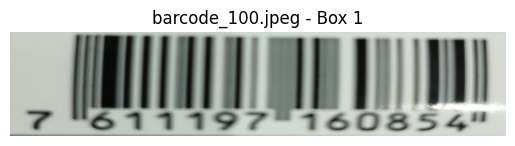

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:42] ppocr DEBUG: dt_boxes num : 2, elapse : 0.1914994716644287
[2024/06/12 11:02:42] ppocr DEBUG: cls num  : 2, elapse : 0.05763602256774902
[2024/06/12 11:02:43] ppocr DEBUG: rec_res num  : 2, elapse : 0.4232800006866455
Codeigo OCR encontrado:  8729516706


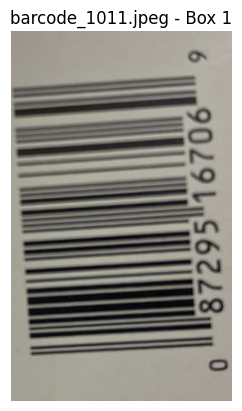

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:43] ppocr DEBUG: dt_boxes num : 0, elapse : 0.09398102760314941
[2024/06/12 11:02:43] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:43] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


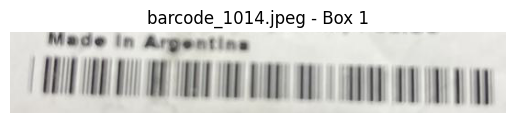

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:43] ppocr DEBUG: dt_boxes num : 1, elapse : 0.18602705001831055
[2024/06/12 11:02:44] ppocr DEBUG: cls num  : 1, elapse : 0.04040718078613281
[2024/06/12 11:02:44] ppocr DEBUG: rec_res num  : 1, elapse : 0.38333559036254883
Codeigo OCR encontrado:  90793-AY418


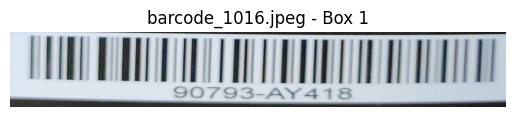

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:44] ppocr DEBUG: dt_boxes num : 1, elapse : 0.06676793098449707
[2024/06/12 11:02:44] ppocr DEBUG: cls num  : 1, elapse : 0.0284116268157959
[2024/06/12 11:02:44] ppocr DEBUG: rec_res num  : 1, elapse : 0.22645950317382812
Codeigo OCR encontrado:  CLE-SPK004


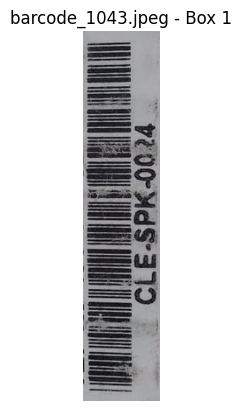

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:45] ppocr DEBUG: dt_boxes num : 0, elapse : 0.08359742164611816
[2024/06/12 11:02:45] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:45] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


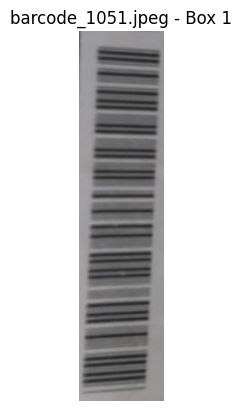

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:45] ppocr DEBUG: dt_boxes num : 1, elapse : 0.15083789825439453
[2024/06/12 11:02:45] ppocr DEBUG: cls num  : 1, elapse : 0.021494150161743164
[2024/06/12 11:02:45] ppocr DEBUG: rec_res num  : 1, elapse : 0.2099320888519287
Codeigo OCR encontrado:  CLE-FSL-0001


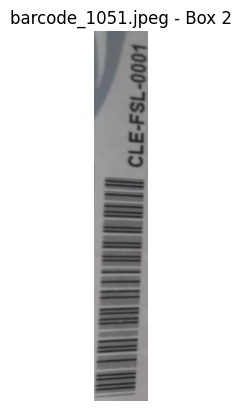

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:46] ppocr DEBUG: dt_boxes num : 0, elapse : 0.03384852409362793
[2024/06/12 11:02:46] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:46] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


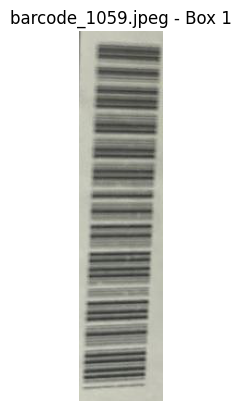

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:46] ppocr DEBUG: dt_boxes num : 0, elapse : 0.023664236068725586
[2024/06/12 11:02:46] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:46] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


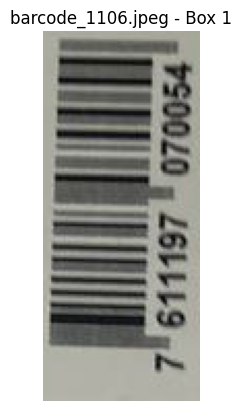

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:46] ppocr DEBUG: dt_boxes num : 1, elapse : 0.1775665283203125
[2024/06/12 11:02:46] ppocr DEBUG: cls num  : 1, elapse : 0.02737879753112793
[2024/06/12 11:02:47] ppocr DEBUG: rec_res num  : 1, elapse : 0.24401283264160156
Codeigo OCR encontrado:  7897707509911


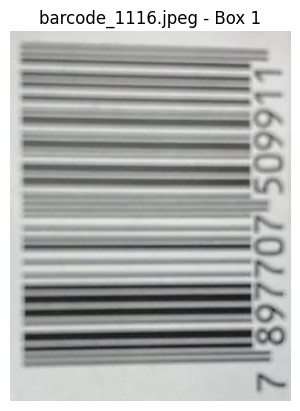

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:47] ppocr DEBUG: dt_boxes num : 1, elapse : 0.19221878051757812
[2024/06/12 11:02:47] ppocr DEBUG: cls num  : 1, elapse : 0.02002406120300293
[2024/06/12 11:02:47] ppocr DEBUG: rec_res num  : 1, elapse : 0.2852606773376465
Codeigo OCR encontrado:  7897707509911


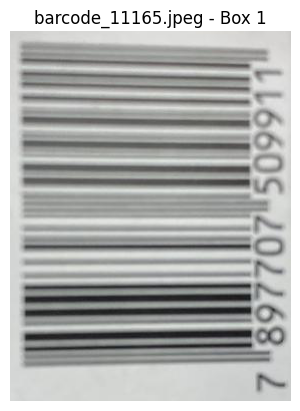

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:48] ppocr DEBUG: dt_boxes num : 0, elapse : 0.028432130813598633
[2024/06/12 11:02:48] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:48] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


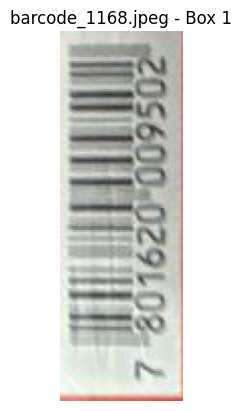

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:48] ppocr DEBUG: dt_boxes num : 0, elapse : 0.025236129760742188
[2024/06/12 11:02:48] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:48] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


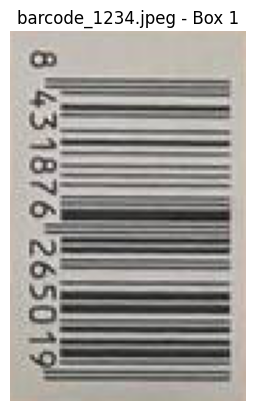

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:48] ppocr DEBUG: dt_boxes num : 0, elapse : 0.036281585693359375
[2024/06/12 11:02:48] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:48] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


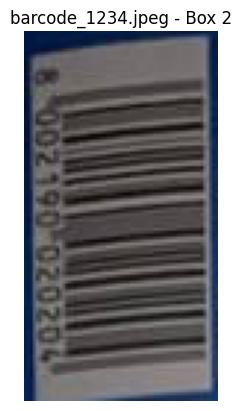

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:48] ppocr DEBUG: dt_boxes num : 0, elapse : 0.038990020751953125
[2024/06/12 11:02:48] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:48] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


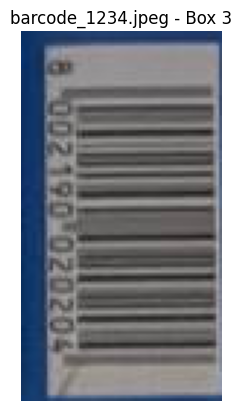

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:49] ppocr DEBUG: dt_boxes num : 0, elapse : 0.04086565971374512
[2024/06/12 11:02:49] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:49] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


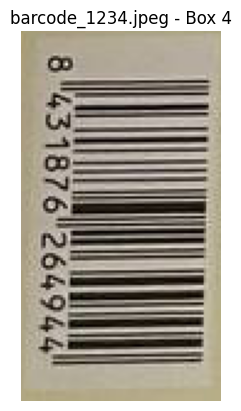

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:49] ppocr DEBUG: dt_boxes num : 0, elapse : 0.027013778686523438
[2024/06/12 11:02:49] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:49] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


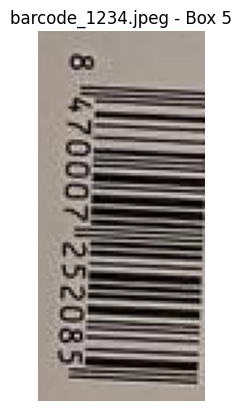

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:49] ppocr DEBUG: dt_boxes num : 0, elapse : 0.02654743194580078
[2024/06/12 11:02:49] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:49] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


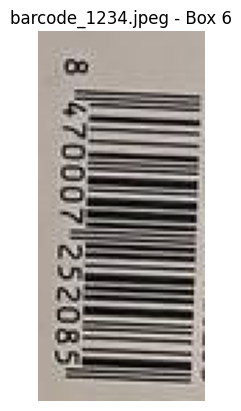

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:49] ppocr DEBUG: dt_boxes num : 0, elapse : 0.03212547302246094
[2024/06/12 11:02:49] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:49] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


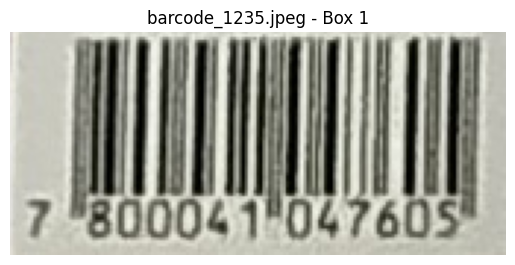

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:50] ppocr DEBUG: dt_boxes num : 0, elapse : 0.035352468490600586
[2024/06/12 11:02:50] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:50] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


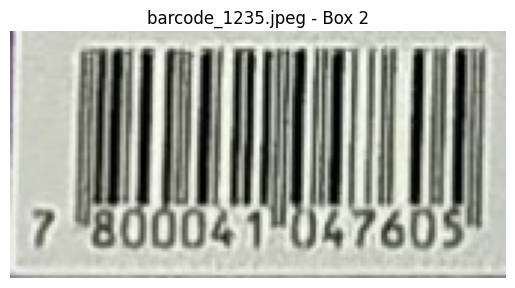

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:50] ppocr DEBUG: dt_boxes num : 1, elapse : 0.04237008094787598
[2024/06/12 11:02:50] ppocr DEBUG: cls num  : 1, elapse : 0.05830740928649902
[2024/06/12 11:02:50] ppocr DEBUG: rec_res num  : 1, elapse : 0.25319480895996094
Codeigo OCR encontrado:  30004104760


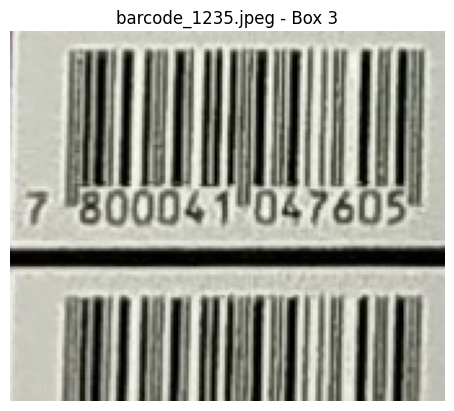

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:51] ppocr DEBUG: dt_boxes num : 0, elapse : 0.03746485710144043
[2024/06/12 11:02:51] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:51] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


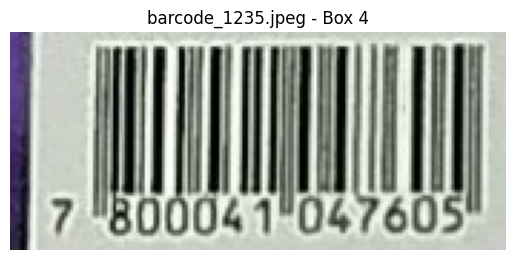

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:51] ppocr DEBUG: dt_boxes num : 0, elapse : 0.02971339225769043
[2024/06/12 11:02:51] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:51] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


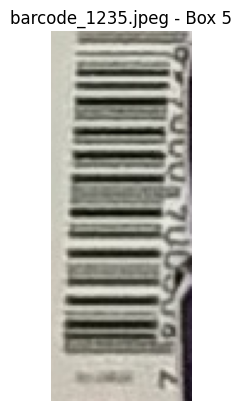

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:51] ppocr DEBUG: dt_boxes num : 0, elapse : 0.0294647216796875
[2024/06/12 11:02:51] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:51] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


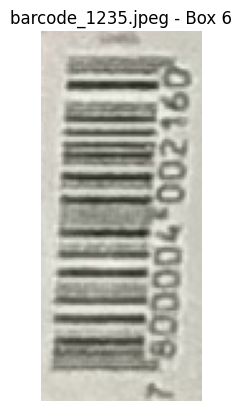

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:51] ppocr DEBUG: dt_boxes num : 0, elapse : 0.043476104736328125
[2024/06/12 11:02:51] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:51] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


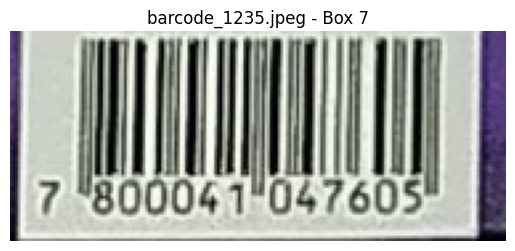

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:51] ppocr DEBUG: dt_boxes num : 0, elapse : 0.04523110389709473
[2024/06/12 11:02:51] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:51] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


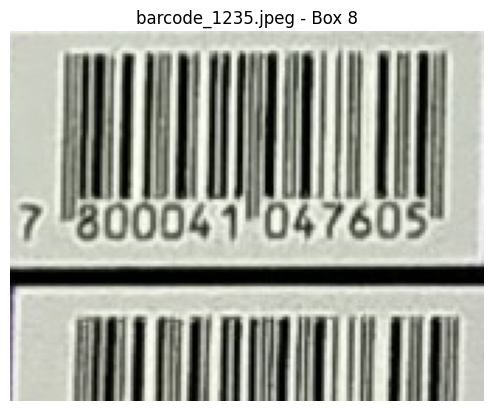

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:52] ppocr DEBUG: dt_boxes num : 0, elapse : 0.05208635330200195
[2024/06/12 11:02:52] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:52] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


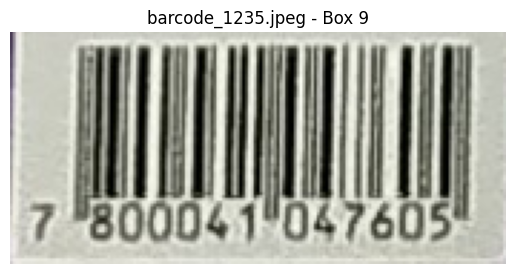

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:52] ppocr DEBUG: dt_boxes num : 1, elapse : 0.05537104606628418
[2024/06/12 11:02:52] ppocr DEBUG: cls num  : 1, elapse : 0.02246546745300293
[2024/06/12 11:02:52] ppocr DEBUG: rec_res num  : 1, elapse : 0.25404882431030273
Codeigo OCR encontrado:  800041047603


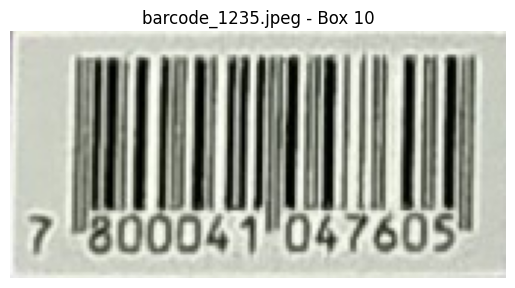

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:52] ppocr DEBUG: dt_boxes num : 0, elapse : 0.02834343910217285
[2024/06/12 11:02:52] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:52] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


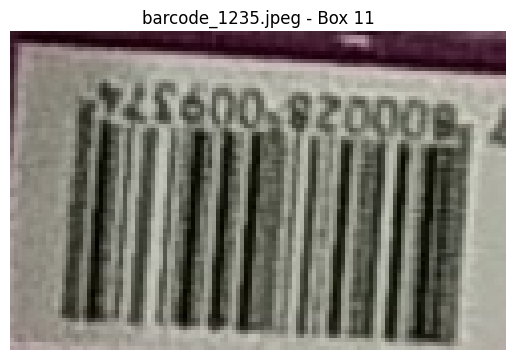

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:53] ppocr DEBUG: dt_boxes num : 0, elapse : 0.025609493255615234
[2024/06/12 11:02:53] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:53] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


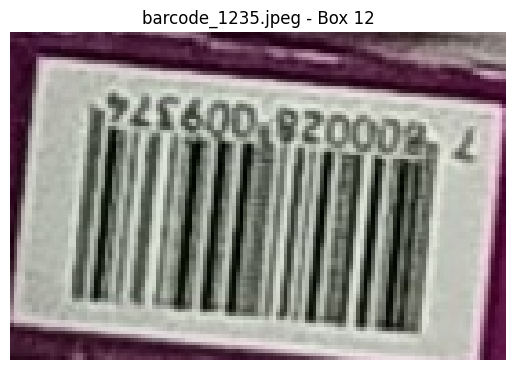

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:53] ppocr DEBUG: dt_boxes num : 0, elapse : 0.02774953842163086
[2024/06/12 11:02:53] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:53] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


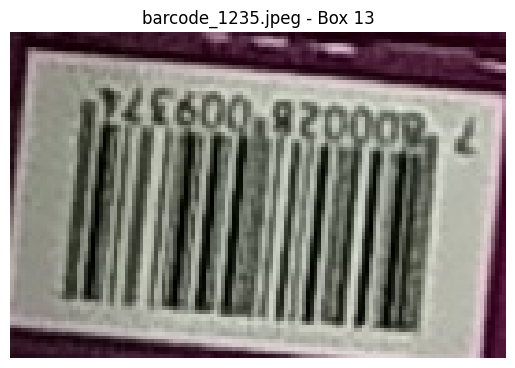

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:53] ppocr DEBUG: dt_boxes num : 0, elapse : 0.03328061103820801
[2024/06/12 11:02:53] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:53] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


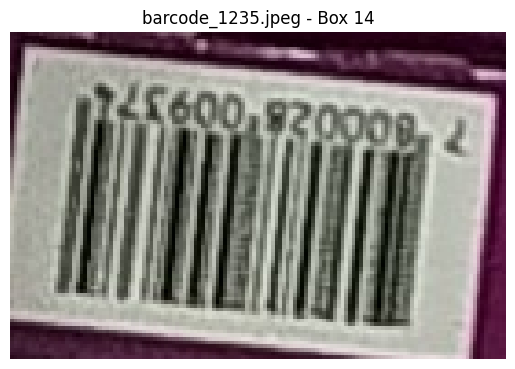

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:53] ppocr DEBUG: dt_boxes num : 0, elapse : 0.02515435218811035
[2024/06/12 11:02:53] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:02:53] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


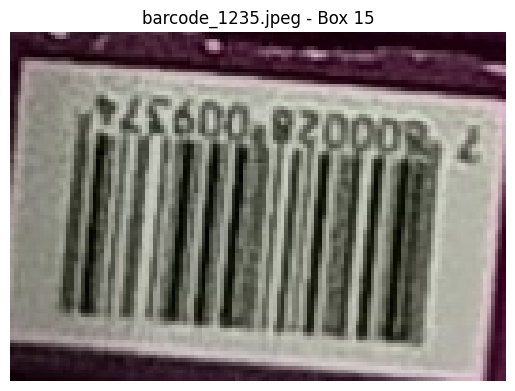

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:54] ppocr DEBUG: dt_boxes num : 1, elapse : 0.1347362995147705
[2024/06/12 11:02:54] ppocr DEBUG: cls num  : 1, elapse : 0.025127649307250977
[2024/06/12 11:02:54] ppocr DEBUG: rec_res num  : 1, elapse : 0.34847044944763184


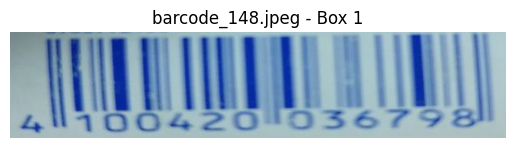

Encontrado código de barras (EAN13): 8431876265019


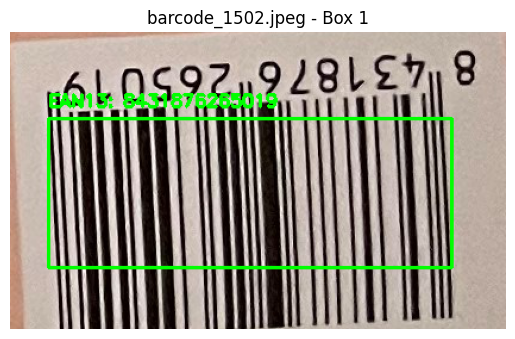

Encontrado código de barras (EAN13): 8431876264944


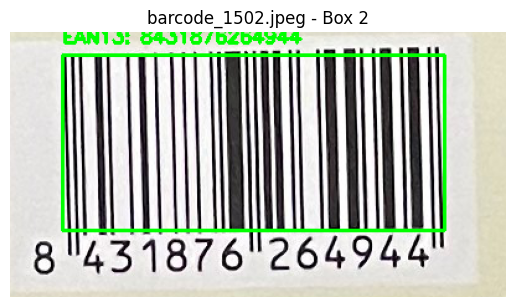

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:55] ppocr DEBUG: dt_boxes num : 1, elapse : 0.07764506340026855
[2024/06/12 11:02:55] ppocr DEBUG: cls num  : 1, elapse : 0.022195100784301758
[2024/06/12 11:02:56] ppocr DEBUG: rec_res num  : 1, elapse : 0.30632662773132324
Codeigo OCR encontrado:  7000728617


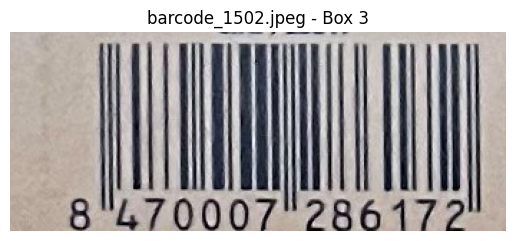

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:56] ppocr DEBUG: dt_boxes num : 1, elapse : 0.09921145439147949
[2024/06/12 11:02:56] ppocr DEBUG: cls num  : 1, elapse : 0.0254514217376709
[2024/06/12 11:02:56] ppocr DEBUG: rec_res num  : 1, elapse : 0.3240981101989746
Codeigo OCR encontrado:  8470007252085


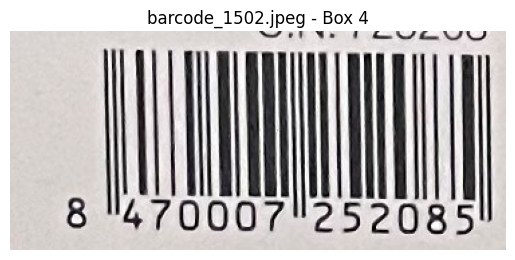

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:57] ppocr DEBUG: dt_boxes num : 2, elapse : 0.16325926780700684
[2024/06/12 11:02:57] ppocr DEBUG: cls num  : 2, elapse : 0.046779632568359375
[2024/06/12 11:02:58] ppocr DEBUG: rec_res num  : 2, elapse : 0.6843233108520508
Codeigo OCR encontrado:  C.N.725208 8470007252085


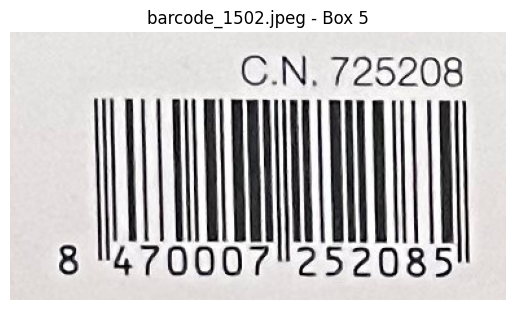

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:58] ppocr DEBUG: dt_boxes num : 1, elapse : 0.14245080947875977
[2024/06/12 11:02:58] ppocr DEBUG: cls num  : 1, elapse : 0.02042865753173828
[2024/06/12 11:02:58] ppocr DEBUG: rec_res num  : 1, elapse : 0.3264458179473877
Codeigo OCR encontrado:  002190020


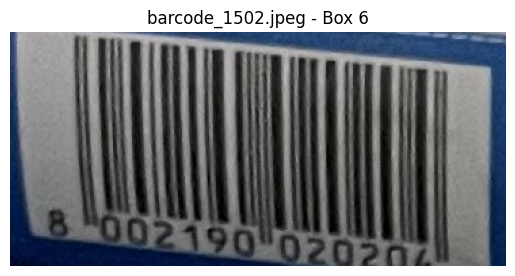

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:02:59] ppocr DEBUG: dt_boxes num : 1, elapse : 0.10098409652709961
[2024/06/12 11:02:59] ppocr DEBUG: cls num  : 1, elapse : 0.03001689910888672
[2024/06/12 11:02:59] ppocr DEBUG: rec_res num  : 1, elapse : 0.3371243476867676
Codeigo OCR encontrado:  8445748529772


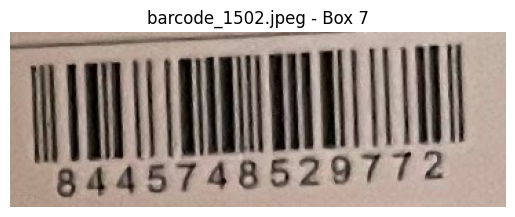

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:03:00] ppocr DEBUG: dt_boxes num : 1, elapse : 0.17614221572875977
[2024/06/12 11:03:00] ppocr DEBUG: cls num  : 1, elapse : 0.02762436866760254
[2024/06/12 11:03:00] ppocr DEBUG: rec_res num  : 1, elapse : 0.22028160095214844
Codeigo OCR encontrado:  11484119305


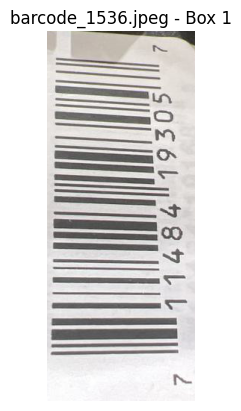

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:03:00] ppocr DEBUG: dt_boxes num : 0, elapse : 0.03678560256958008
[2024/06/12 11:03:00] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:03:00] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


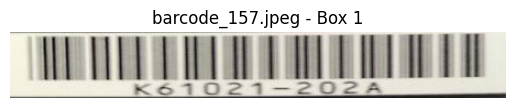

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:03:00] ppocr DEBUG: dt_boxes num : 0, elapse : 0.045655250549316406
[2024/06/12 11:03:00] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:03:00] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


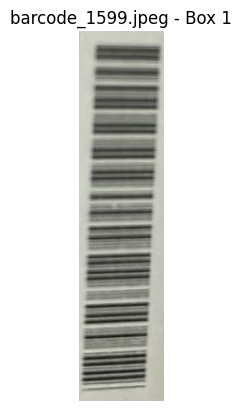

Encontrado código de barras (EAN13): 4100420015724


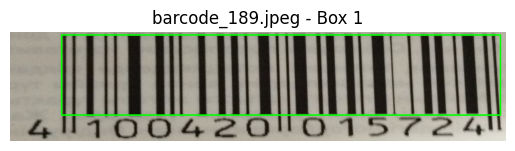

Encontrado código de barras (EAN13): 8712569001542


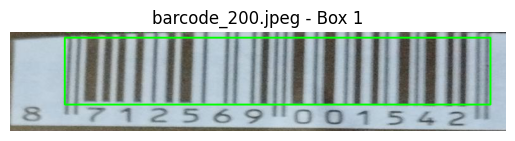

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:03:03] ppocr DEBUG: dt_boxes num : 1, elapse : 1.0926387310028076
[2024/06/12 11:03:03] ppocr DEBUG: cls num  : 1, elapse : 0.037812232971191406
[2024/06/12 11:03:03] ppocr DEBUG: rec_res num  : 1, elapse : 0.28942179679870605
Codeigo OCR encontrado:  1211100397


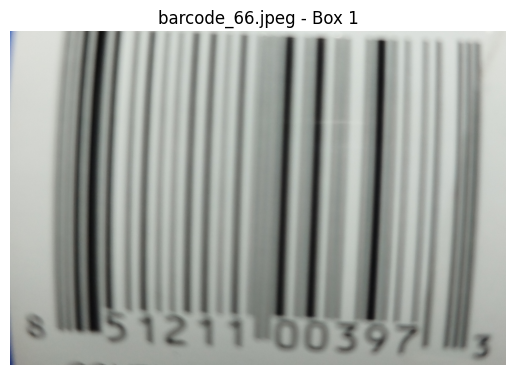

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:03:05] ppocr DEBUG: dt_boxes num : 1, elapse : 0.2996673583984375
[2024/06/12 11:03:05] ppocr DEBUG: cls num  : 1, elapse : 0.0342097282409668
[2024/06/12 11:03:05] ppocr DEBUG: rec_res num  : 1, elapse : 0.23316645622253418
Codeigo OCR encontrado:  CLE-CBH-0013


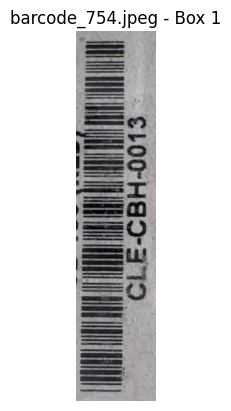

Encontrado código de barras (EAN13): 3374650247380


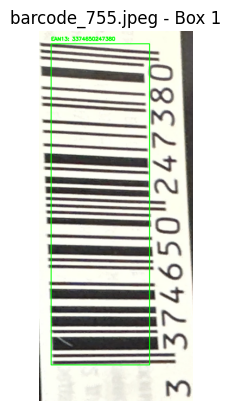

Encontrado código de barras (EAN13): 0087295166819


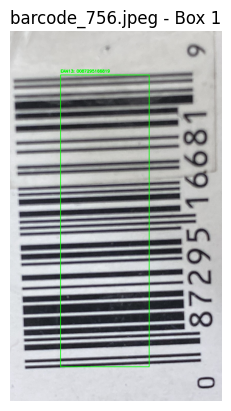

Encontrado código de barras (CODE39): ACCFORKF0010


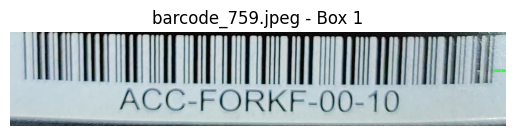

Encontrado código de barras (EAN13): 4100420030932


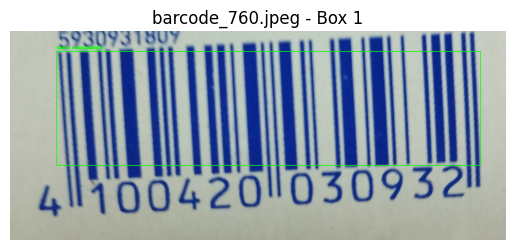

Encontrado código de barras (EAN13): 3661451001380


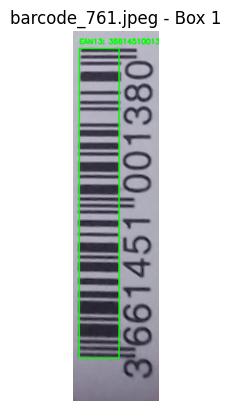

Encontrado código de barras (EAN13): 0087295165973


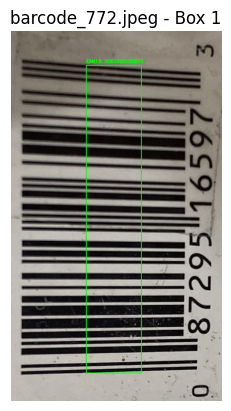

Encontrado código de barras (EAN13): 7801610481004


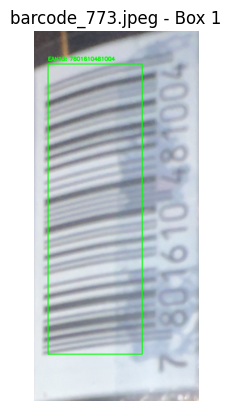

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:03:12] ppocr DEBUG: dt_boxes num : 5, elapse : 0.3308115005493164
[2024/06/12 11:03:12] ppocr DEBUG: cls num  : 5, elapse : 0.1539616584777832
[2024/06/12 11:03:14] ppocr DEBUG: rec_res num  : 5, elapse : 1.8701534271240234
Codeigo OCR encontrado:  K01250-00200017Y10-7 101250-00200017V36-7 629440529 7804629440529 7804629440529


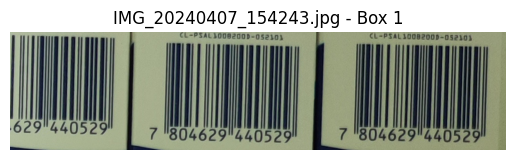

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:03:14] ppocr DEBUG: dt_boxes num : 1, elapse : 0.10326313972473145
[2024/06/12 11:03:14] ppocr DEBUG: cls num  : 1, elapse : 0.03425741195678711
[2024/06/12 11:03:15] ppocr DEBUG: rec_res num  : 1, elapse : 0.42156362533569336
Codeigo OCR encontrado:  7 730969304552


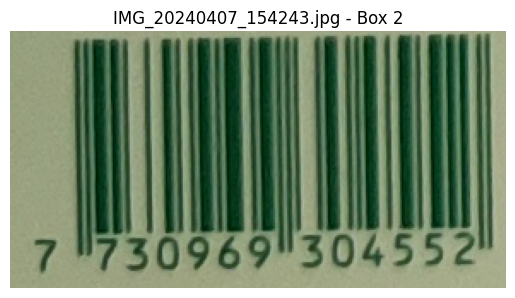

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:03:15] ppocr DEBUG: dt_boxes num : 1, elapse : 0.10363578796386719
[2024/06/12 11:03:15] ppocr DEBUG: cls num  : 1, elapse : 0.0312192440032959
[2024/06/12 11:03:15] ppocr DEBUG: rec_res num  : 1, elapse : 0.3770151138305664
Codeigo OCR encontrado:  7 800028841486


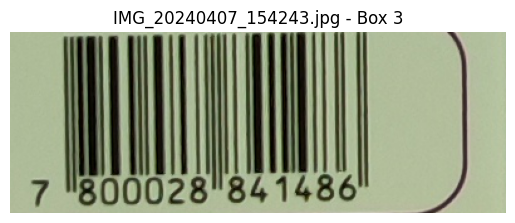

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:03:16] ppocr DEBUG: dt_boxes num : 1, elapse : 0.07620739936828613
[2024/06/12 11:03:16] ppocr DEBUG: cls num  : 1, elapse : 0.039546966552734375
[2024/06/12 11:03:16] ppocr DEBUG: rec_res num  : 1, elapse : 0.3247542381286621


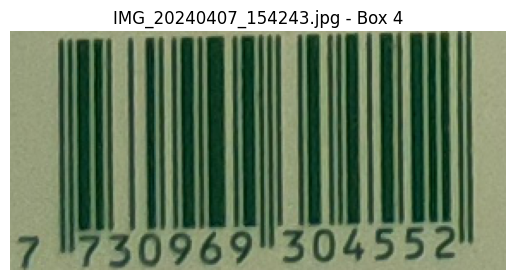

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:03:16] ppocr DEBUG: dt_boxes num : 1, elapse : 0.07598733901977539
[2024/06/12 11:03:16] ppocr DEBUG: cls num  : 1, elapse : 0.04744863510131836
[2024/06/12 11:03:17] ppocr DEBUG: rec_res num  : 1, elapse : 0.3556196689605713
Codeigo OCR encontrado:  30969130455


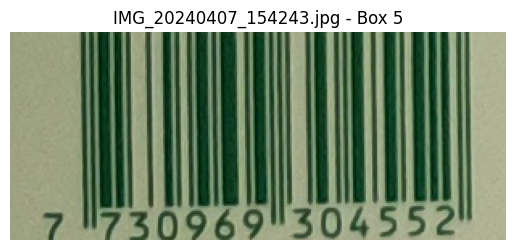

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:03:17] ppocr DEBUG: dt_boxes num : 0, elapse : 0.08446311950683594
[2024/06/12 11:03:17] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/12 11:03:17] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


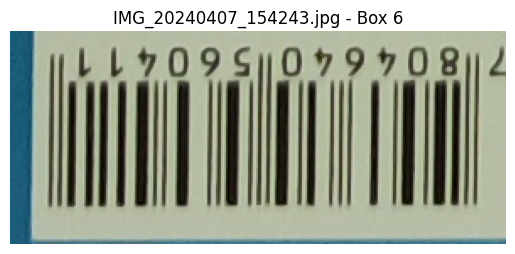

Encontrado código de barras (EAN13): 7501438312398


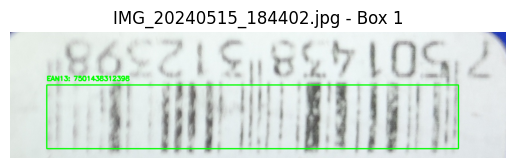

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:03:19] ppocr DEBUG: dt_boxes num : 2, elapse : 0.2971663475036621
[2024/06/12 11:03:19] ppocr DEBUG: cls num  : 2, elapse : 0.0598149299621582
[2024/06/12 11:03:20] ppocr DEBUG: rec_res num  : 2, elapse : 0.43239283561706543
Codeigo OCR encontrado:  669000 300000


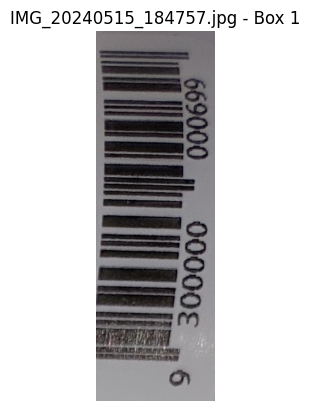

Encontrado código de barras (EAN13): 9300000000699


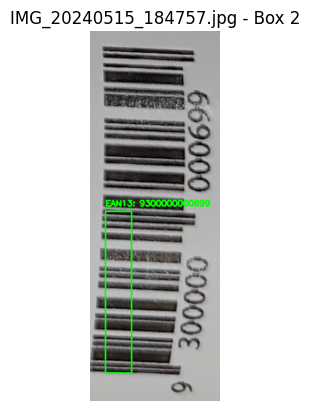

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:03:20] ppocr DEBUG: dt_boxes num : 3, elapse : 0.28351569175720215
[2024/06/12 11:03:20] ppocr DEBUG: cls num  : 3, elapse : 0.0882723331451416
[2024/06/12 11:03:21] ppocr DEBUG: rec_res num  : 3, elapse : 0.6354093551635742
Codeigo OCR encontrado:  669000 300000 9


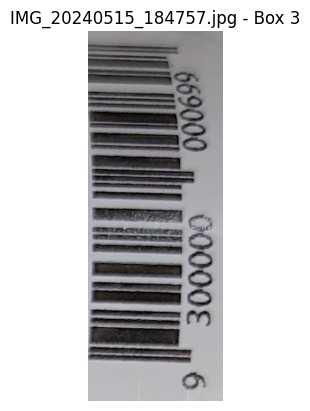

Encontrado código de barras (EAN13): 9300000000699


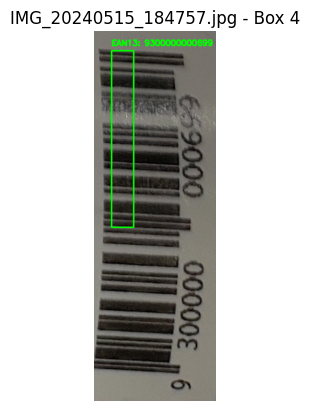

Encontrado código de barras (EAN13): 9300000000699


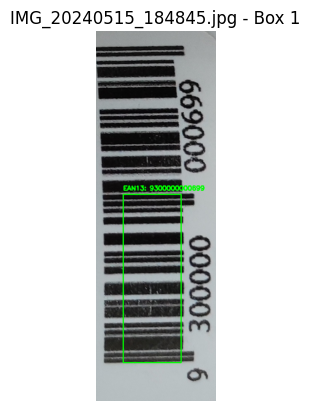

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/12 11:03:23] ppocr DEBUG: dt_boxes num : 3, elapse : 0.4832732677459717
[2024/06/12 11:03:23] ppocr DEBUG: cls num  : 3, elapse : 0.09970378875732422
[2024/06/12 11:03:24] ppocr DEBUG: rec_res num  : 3, elapse : 0.5724577903747559
Codeigo OCR encontrado:  669000 300000


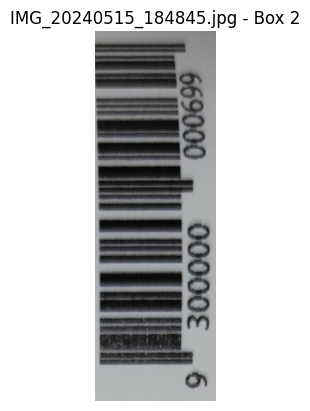

Encontrado código de barras (EAN13): 7804671180114


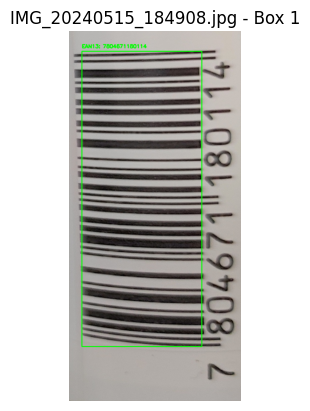

Encontrado código de barras (EAN13): 7804671180114


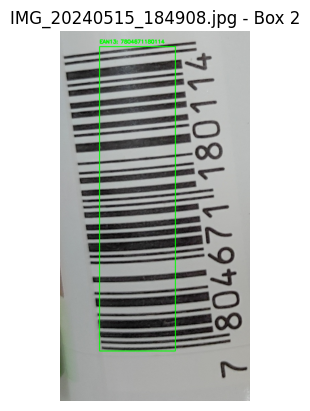

Encontrado código de barras (EAN13): 7804671180114


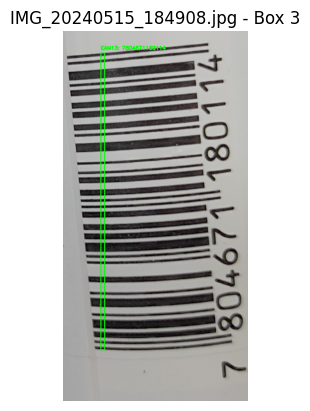

Encontrado código de barras (EAN13): 7804671180114


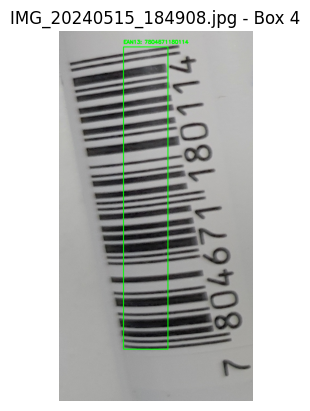

In [12]:
def mostrar_subimagenes(imagenes, grosor=2, umbral=0.65):
    for nombre, imagen in imagenes:
        imagen_cv2 = cv2.cvtColor(np.array(imagen), cv2.COLOR_RGB2BGR)
        results = model.predict(source=imagen_cv2, stream=True, verbose=False)
        
        box_coords = []
        for result in results:
            boxes = result.boxes.xyxy.cpu().numpy()
            confs = result.boxes.conf.cpu().numpy()
            for box, conf in zip(boxes, confs):
                if conf > umbral:
                    x1, y1, x2, y2 = map(int, box)
                    box_coords.append((x1, y1, x2, y2))

        subimagenes = extraer_subimagenes(imagen_cv2, box_coords)
        
        for i, subimagen in enumerate(subimagenes):
            imagen_filtrada = procesar_imagen(subimagen)
            _, binary_image = cv2.threshold(imagen_filtrada, 250, 251, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

            codigos_barras = pyzbar.decode(imagen_filtrada)
            
            
            # scores = [res1[1][1] for res1 in result1[0]]

            for codigo in codigos_barras:
                x, y, w, h = codigo.rect
                cv2.rectangle(subimagen, (x, y), (x + w, y + h), (0, 255, 0), 2)
                texto_codigo = codigo.data.decode('utf-8')
                tipo_codigo = codigo.type
                
                
                cv2.putText(subimagen, f'{tipo_codigo}: {texto_codigo}', (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
                print(f"Encontrado código de barras ({tipo_codigo}): {texto_codigo}")
                
            if not codigos_barras:
                
                print ("Sin codigo de barras legible")
                print ("Comenzando con el reconocimiento OCR")
                result1 = ocr_model.ocr(imagen_filtrada, cls=True)
                #boxes1 = [res1[0] for res1 in result1[0]]
                texts = [res1[1][0] for res1 in result1[0]]
                if len(texts) > 1:
                    
                    texts = [' '.join(texts)]
                else:
                    texts = texts
                for text in texts:
                        print(f"Codeigo OCR encontrado: ", text )
                if result1==None :
                    print(f"Vuelva a sacar la foto " )

                
            
            subimagen_rgb = cv2.cvtColor(subimagen, cv2.COLOR_BGR2RGB)
            plt.figure()
            plt.imshow(subimagen_rgb)
            plt.title(f'{nombre} - Box {i+1}')
            plt.axis('off')
            plt.show()

model = YOLO("barras.pt")

directorio_imagenes = r'C:\Users\ferve\Downloads\Barcodes\Barcodes\Prueba'

imagenes = extraer_imagenes(directorio_imagenes)
mostrar_subimagenes(imagenes, grosor=9, umbral=0.10)  


PRUEBAS DE FILTRADO 

In [10]:
def mostrar_subimagenes(imagenes, grosor=2, umbral=0.65):
    for nombre, imagen in imagenes:
        imagen_cv2 = cv2.cvtColor(np.array(imagen), cv2.COLOR_RGB2BGR)
        results = model.predict(source=imagen_cv2, stream=True, verbose=False)
        
        box_coords = []
        for result in results:
            boxes = result.boxes.xyxy.cpu().numpy()
            confs = result.boxes.conf.cpu().numpy()
            for box, conf in zip(boxes, confs):
                if conf > umbral:
                    x1, y1, x2, y2 = map(int, box)
                    box_coords.append((x1, y1, x2, y2))

        subimagenes = extraer_subimagenes(imagen_cv2, box_coords)
        
        for i, subimagen in enumerate(subimagenes):
            imagen_filtrada = procesar_imagen(subimagen)
            _, binary_image = cv2.threshold(imagen_filtrada, 250, 251, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
            print("imagen filtrada antes")
            imagen_filtrada = denoise.denoise_nl_means(subimagen, patch_size=7, patch_distance=11, h=0.1)
            print("imagen filtrada", imagen_filtrada)


            codigos_barras = pyzbar.decode(imagen_filtrada)
            
            result1 = ocr_model.ocr(imagen_filtrada, cls=True)
            #boxes1 = [res1[0] for res1 in result1[0]]
            texts = [res1[1][0] for res1 in result1[0]]
            if len(texts) > 1:
                
                texts = [' '.join(texts)]
            else:
                texts = texts
            for text in texts:
                    print(f"texts ", text )
            # scores = [res1[1][1] for res1 in result1[0]]

            for codigo in codigos_barras:
                x, y, w, h = codigo.rect
                cv2.rectangle(subimagen, (x, y), (x + w, y + h), (0, 255, 0), 2)
                texto_codigo = codigo.data.decode('utf-8')
                tipo_codigo = codigo.type
                
                
                cv2.putText(subimagen, f'{tipo_codigo}: {texto_codigo}', (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
                print(f"Encontrado código de barras ({tipo_codigo}): {texto_codigo}")
                
            if not codigos_barras:
                
                print ("code", codigos_barras)

                
            
            subimagen_rgb = cv2.cvtColor(imagen_filtrada, cv2.COLOR_BGR2RGB)
            plt.figure()
            plt.imshow(subimagen_rgb)
            plt.title(f'{nombre} - Box {i+1}')
            plt.axis('off')
            plt.show()

model = YOLO("barras.pt")

directorio_imagenes = r'C:\Users\ferve\Downloads\Barcodes\Barcodes\Prueba'

imagenes = extraer_imagenes(directorio_imagenes)
mostrar_subimagenes(imagenes, grosor=9, umbral=0.10)  


imagen filtrada antes


Reconocimiento 4 a 6 productos

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/16 20:50:03] ppocr DEBUG: dt_boxes num : 0, elapse : 0.516676664352417
[2024/06/16 20:50:03] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/16 20:50:03] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


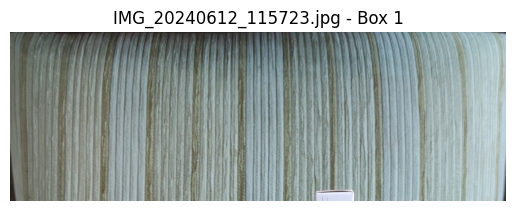

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/16 20:50:05] ppocr DEBUG: dt_boxes num : 0, elapse : 0.22507238388061523
[2024/06/16 20:50:05] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/16 20:50:05] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


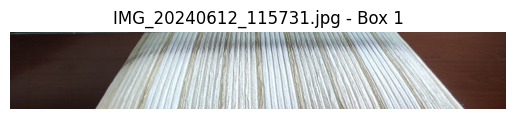

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/16 20:50:07] ppocr DEBUG: dt_boxes num : 0, elapse : 0.4290177822113037
[2024/06/16 20:50:07] ppocr DEBUG: cls num  : 0, elapse : 0
[2024/06/16 20:50:07] ppocr DEBUG: rec_res num  : 0, elapse : 0.0


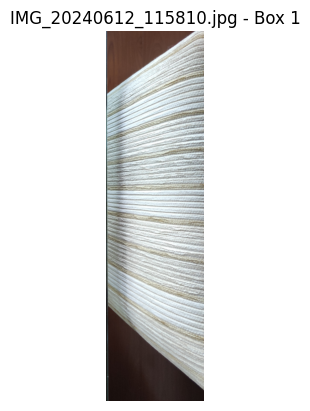

Sin codigo de barras legible
Comenzando con el reconocimiento OCR
[2024/06/16 20:50:10] ppocr DEBUG: dt_boxes num : 1, elapse : 0.0955648422241211
[2024/06/16 20:50:10] ppocr DEBUG: cls num  : 1, elapse : 0.026999711990356445
[2024/06/16 20:50:10] ppocr DEBUG: rec_res num  : 1, elapse : 0.25815749168395996
Codeigo OCR encontrado:  005800 241901


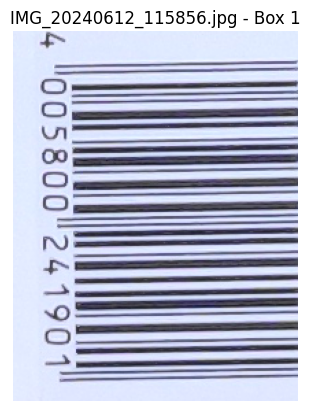

In [9]:
def mostrar_subimagenes(imagenes, grosor=2, umbral=0.65):
    for nombre, imagen in imagenes:
        imagen_cv2 = cv2.cvtColor(np.array(imagen), cv2.COLOR_RGB2BGR)
        results = model.predict(source=imagen_cv2, stream=True, verbose=False)
        
        box_coords = []
        for result in results:
            boxes = result.boxes.xyxy.cpu().numpy()
            confs = result.boxes.conf.cpu().numpy()
            for box, conf in zip(boxes, confs):
                if conf > umbral:
                    x1, y1, x2, y2 = map(int, box)
                    box_coords.append((x1, y1, x2, y2))

        subimagenes = extraer_subimagenes(imagen_cv2, box_coords)
        
        for i, subimagen in enumerate(subimagenes):
            imagen_filtrada = procesar_imagen(subimagen)
            _, binary_image = cv2.threshold(imagen_filtrada, 250, 251, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

            codigos_barras = pyzbar.decode(imagen_filtrada)
            
            
            # scores = [res1[1][1] for res1 in result1[0]]

            for codigo in codigos_barras:
                x, y, w, h = codigo.rect
                cv2.rectangle(subimagen, (x, y), (x + w, y + h), (0, 255, 0), 2)
                texto_codigo = codigo.data.decode('utf-8')
                tipo_codigo = codigo.type
                
                
                cv2.putText(subimagen, f'{tipo_codigo}: {texto_codigo}', (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
                print(f"Encontrado código de barras ({tipo_codigo}): {texto_codigo}")
                
            if not codigos_barras:
                
                print ("Sin codigo de barras legible")
                print ("Comenzando con el reconocimiento OCR")
                result1 = ocr_model.ocr(imagen_filtrada, cls=True)
                #boxes1 = [res1[0] for res1 in result1[0]]
                texts = [res1[1][0] for res1 in result1[0]]
                if len(texts) > 1:
                    
                    texts = [' '.join(texts)]
                else:
                    texts = texts
                for text in texts:
                        print(f"Codeigo OCR encontrado: ", text )
                if result1==None :
                    print(f"Vuelva a sacar la foto " )

                
            
            subimagen_rgb = cv2.cvtColor(subimagen, cv2.COLOR_BGR2RGB)
            plt.figure()
            plt.imshow(subimagen_rgb)
            plt.title(f'{nombre} - Box {i+1}')
            plt.axis('off')
            plt.show()

model = YOLO("barras.pt")

#directorio_imagenes = r'C:\Users\ferve\Downloads\Barcodes\Barcodes\Prueba'

directorio_imagenes = r'G:\INNOVAI\Test'

imagenes = extraer_imagenes(directorio_imagenes)
mostrar_subimagenes(imagenes, grosor=9, umbral=0.10)  


Encontrado código de barras (CODE39): 981070154 


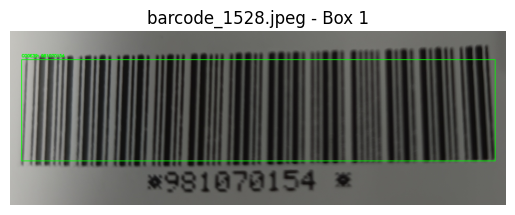

Sin código de barras legible
Comenzando con el reconocimiento OCR
[2024/06/16 22:24:08] ppocr DEBUG: dt_boxes num : 1, elapse : 0.636768102645874
[2024/06/16 22:24:08] ppocr DEBUG: cls num  : 1, elapse : 0.026000499725341797
[2024/06/16 22:24:09] ppocr DEBUG: rec_res num  : 1, elapse : 0.34944725036621094
Código OCR encontrado: 10042011015724


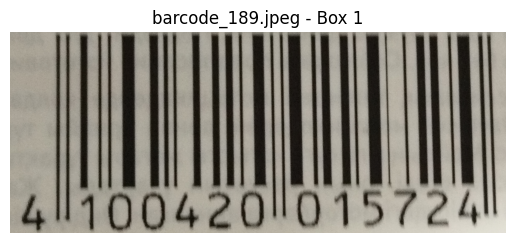

In [15]:

def guardar_en_json(data, nombre_archivo):
    with open(nombre_archivo, 'w') as f:
        json.dump(data, f, indent=4)

def mostrar_subimagenes(imagenes, grosor=2, umbral=0.65, output_json='resultados.json'):
    resultados = []
    
    for nombre, imagen in imagenes:
        imagen_cv2 = cv2.cvtColor(np.array(imagen), cv2.COLOR_RGB2BGR)
        results = model.predict(source=imagen_cv2, stream=True, verbose=False)
        
        box_coords = []
        for result in results:
            boxes = result.boxes.xyxy.cpu().numpy()
            confs = result.boxes.conf.cpu().numpy()
            for box, conf in zip(boxes, confs):
                if conf > umbral:
                    x1, y1, x2, y2 = map(int, box)
                    box_coords.append((x1, y1, x2, y2))

        subimagenes = extraer_subimagenes(imagen_cv2, box_coords)
        
        for i, subimagen in enumerate(subimagenes):
            imagen_filtrada = procesar_imagen(subimagen)
            _, binary_image = cv2.threshold(imagen_filtrada, 250, 251, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

            codigos_barras = pyzbar.decode(imagen_filtrada)
            info_imagen = {"id": nombre, "nombre_imagen": nombre, "codigos_barras": [], "ocr": []}

            for codigo in codigos_barras:
                x, y, w, h = codigo.rect
                cv2.rectangle(subimagen, (x, y), (x + w, y + h), (0, 255, 0), 2)
                texto_codigo = codigo.data.decode('utf-8')
                tipo_codigo = codigo.type
                cv2.putText(subimagen, f'{tipo_codigo}: {texto_codigo}', (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
                print(f"Encontrado código de barras ({tipo_codigo}): {texto_codigo}")
                info_imagen["codigos_barras"].append({"tipo": tipo_codigo, "texto": texto_codigo, "coordenadas": [x, y, w, h]})

            if not codigos_barras:
                print("Sin código de barras legible")
                print("Comenzando con el reconocimiento OCR")
                result1 = ocr_model.ocr(imagen_filtrada, cls=True)
                texts = [res1[1][0] for res1 in result1[0]]
                boxes1 = [res1[0] for res1 in result1[0]]
                ocr_info = []

                if len(texts) > 1:
                    texts = [' '.join(texts)]
                for text, box in zip(texts, boxes1):
                    print(f"Código OCR encontrado: {text}")
                    ocr_info.append({"texto": text, "coordenadas": box})
                info_imagen["ocr"].extend(ocr_info)
                if not result1:
                    print("Vuelva a sacar la foto")

            subimagen_rgb = cv2.cvtColor(subimagen, cv2.COLOR_BGR2RGB)
            plt.figure()
            plt.imshow(subimagen_rgb)
            plt.title(f'{nombre} - Box {i+1}')
            plt.axis('off')
            plt.show()

            resultados.append(info_imagen)
    
    guardar_en_json(resultados, output_json)

model = YOLO("barras.pt")

directorio_imagenes = r'G:\INNOVAI\Test'
imagenes = extraer_imagenes(directorio_imagenes)
directorio_imagenes2 = r'G:\INNOVAI\barcode_advance\Barcode_and_OCR'
output_json_path = os.path.join(directorio_imagenes2, 'resultados.json')
mostrar_subimagenes(imagenes, grosor=9, umbral=0.10, output_json=output_json_path)

Testeo de imagenes nuevas

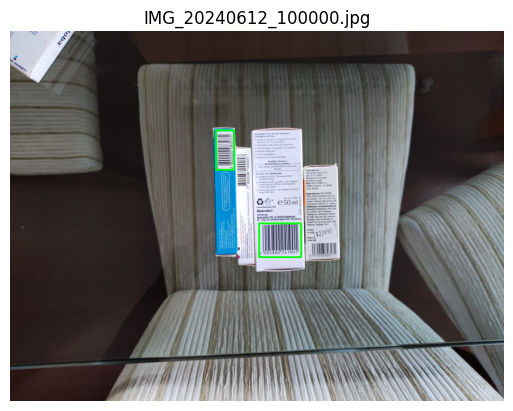

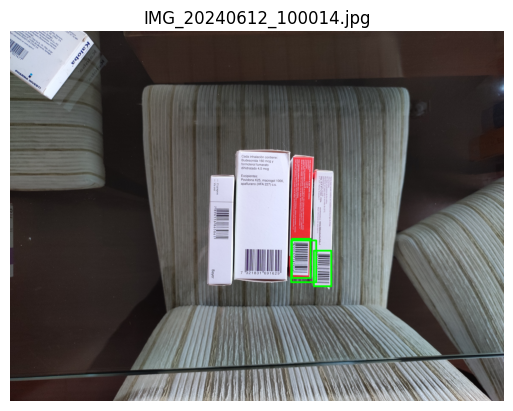

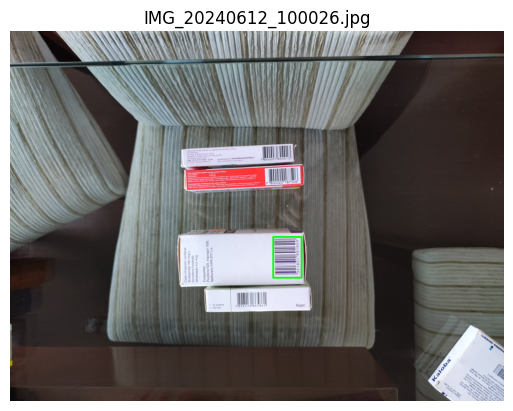

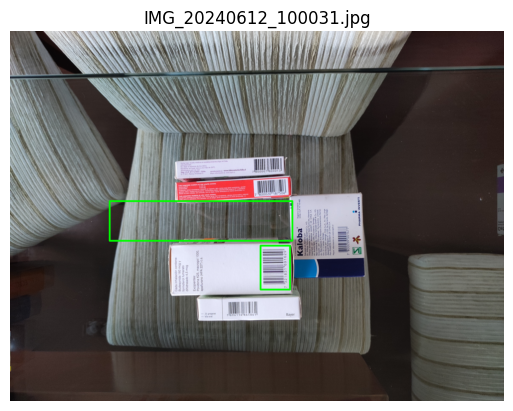

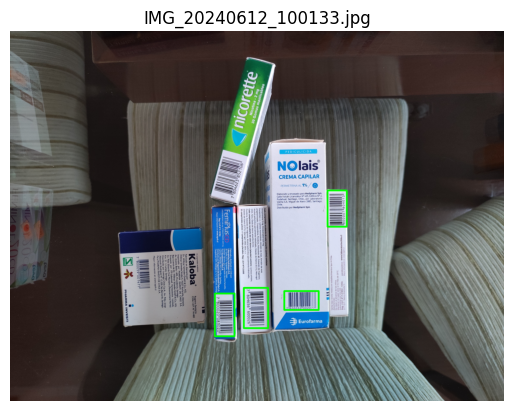

...

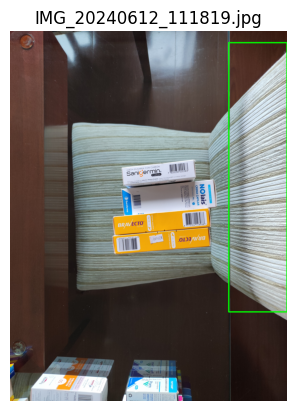

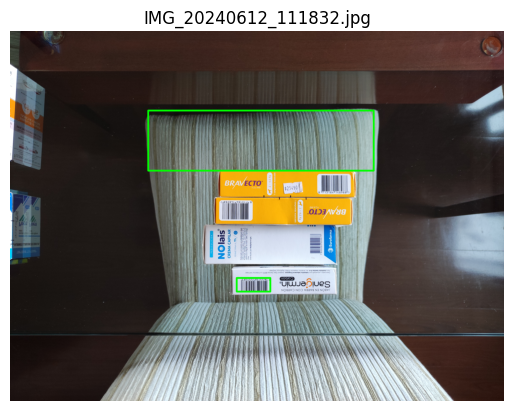

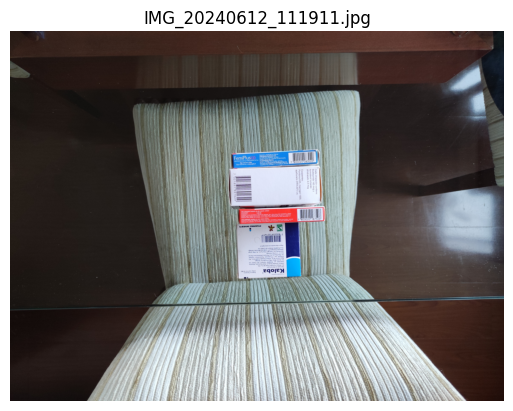

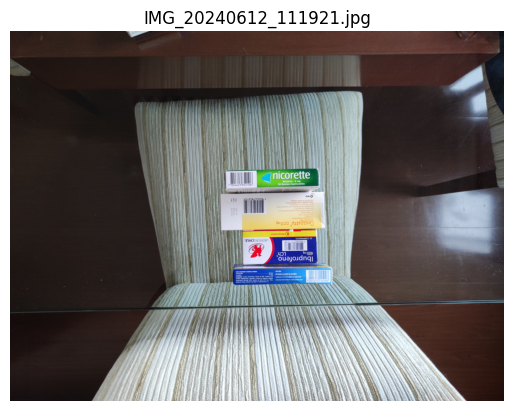

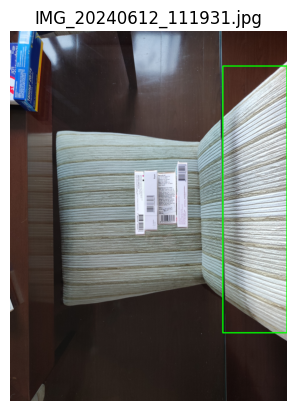

In [18]:
import os
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from ultralytics import YOLO
from pyzbar import pyzbar

# Función para extraer y leer imágenes de un directorio
def extraer_imagenes(directorio):
    imagenes = []
    for archivo in os.listdir(directorio):
        if archivo.endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif')):
            ruta_completa = os.path.join(directorio, archivo)
            imagen = Image.open(ruta_completa)
            imagenes.append((archivo, imagen))
    return imagenes

# Función para dibujar cajas delimitadoras en las imágenes
def dibujar_cajas(imagen, box_coords):
    for box in box_coords:
        x1, y1, x2, y2 = box
        cv2.rectangle(imagen, (x1, y1), (x2, y2), (0, 255, 0), 15)
    return imagen

# Función para mostrar y guardar las imágenes con las cajas
def mostrar_y_guardar_imagenes(imagenes, directorio_salida):
    if not os.path.exists(directorio_salida):
        os.makedirs(directorio_salida)
    
    for nombre, imagen in imagenes:
        imagen_cv2 = cv2.cvtColor(np.array(imagen), cv2.COLOR_RGB2BGR)
        results = model.predict(source=imagen_cv2, stream=True, verbose=False)
        
        box_coords = []
        for result in results:
            for box in result.boxes:
                x1, y1, x2, y2 = map(int, box.xyxy[0])
                box_coords.append((x1, y1, x2, y2))
        
        imagen_con_cajas = dibujar_cajas(imagen_cv2, box_coords)
        imagen_con_cajas_rgb = cv2.cvtColor(imagen_con_cajas, cv2.COLOR_BGR2RGB)
        
        plt.figure()
        plt.imshow(imagen_con_cajas_rgb)
        plt.title(nombre)
        plt.axis('off')
        plt.show()
        
        # Guardar la imagen con las cajas en el directorio de salida
        ruta_salida = os.path.join(directorio_salida, nombre)
        cv2.imwrite(ruta_salida, imagen_con_cajas)

# Inicializar el modelo YOLO
model = YOLO("barras.pt")

# Ruta del directorio que contiene las imágenes
# C:\Users\ferve\Downloads\Codigos_4-6_productos\ParaTest
#directorio_imagenes = r'G:\INNOVAI\Test'
directorio_imagenes = r'C:\Users\ferve\Downloads\Codigos_4-6_productos\ParaTest'
directorio_salida = r'G:\INNOVAI\Test\test'

# Extraer y mostrar las imágenes
imagenes = extraer_imagenes(directorio_imagenes)
mostrar_y_guardar_imagenes(imagenes, directorio_salida)


In [6]:
directorio_imagenes = r'C:\Users\ferve\Downloads\Barcodes\Barcodes\Prueba\barcode_100.jpeg'
# Load the noisy image
#noisy_image = io.imread("path/to/your/noisy_image.jpg")
#noisy_image = cv2.imread(directorio_imagenes, cv2.IMREAD_COLOR)

noisy_image = cv2.imread(directorio_imagenes)

# Denoise with patch size 9, search area radius 15, and smoothing factor 0.2
denoised_image = denoise.denoise_nl_means(noisy_image, patch_size=9, patch_distance=15, h=0.2)

# Save the denoised image
io.imsave("denoised_image_custom.jpg", denoised_image)